# Summary: Aggregation of chi values per country<a class="tocSkip"></a>

_<a href= "mailto:alexander.dunkel@tu-dresden.de">Alexander Dunkel</a>, TU Dresden, Institute of Cartography;  Maximilian Hartmann, Universität Zürich (UZH), Geocomputation_

----------------

In [4]:
from IPython.display import Markdown as md
from datetime import date

today = date.today()
with open('/.version', 'r') as file: app_version = file.read().split("'")[1]
md(f"Last updated: {today.strftime('%b-%d-%Y')}, [Carto-Lab Docker](https://gitlab.vgiscience.de/lbsn/tools/jupyterlab) Version {app_version}")

Last updated: Oct-08-2022, [Carto-Lab Docker](https://gitlab.vgiscience.de/lbsn/tools/jupyterlab) Version 0.9.0

# Introduction

In this notebook, aggregate data per grid bin is used to generate summary data (chi square) per country. We'll use the 50 km grid data, to reduce errors from [MAUP](https://de.wikipedia.org/wiki/MAUP). Our goal is to see whether some countries feature a bias towards either sunset or sunrise, to support discussion of possible context factors.

# Preparations

## Load dependencies

Import code from other jupyter notebooks, synced to *.py with jupytext:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
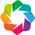

Chromedriver loaded. Svg output enabled.


In [5]:
import sys
from pathlib import Path
module_path = str(Path.cwd().parents[0] / "py")
if module_path not in sys.path:
    sys.path.append(module_path)
# import all previous chained notebooks
from _04_combine import *
from modules import preparations
preparations.init_imports()
WEB_DRIVER = preparations.load_chromedriver()

Load additional dependencies

In [6]:
import requests, zipfile, io

## Parameters

Activate autoreload of changed python files:

In [7]:
%load_ext autoreload
%autoreload 2

Via `gp.datasets.get_path('naturalearth_lowres')`, country geometries area easily available. However, these do not include separated spatial region subunits, which would combine all overseas regions of e.g. France together. In the admin-0 natural earth subunits dataset, these subunit areas are available.

- [Natural Earth map units shapefile (1:50m)][ne50]

[ne50]: https://www.naturalearthdata.com/downloads/50m-cultural-vectors/50m-admin-0-details/

In [8]:
NE_PATH = Path.cwd().parents[0] / "resources" / "naturalearth"
NE_URI = "https://www.naturalearthdata.com/http//www.naturalearthdata.com/download/50m/cultural/"
NE_FILENAME = "ne_50m_admin_0_map_subunits.zip"

# Country aggregation

## Load grid geometry

In [9]:
grid_empty = create_grid_df(
    grid_size=50000)
grid_empty = grid_to_gdf(grid_empty)

## Load country geometry

In [10]:
def get_zip_extract(
    uri: str, filename: str, output_path: Path, 
    create_path: bool = True, skip_exists: bool = True,
    report: bool = False):
    """Get Zip file and extract to output_path.
    Create Path if not exists."""
    if create_path:
        output_path.mkdir(
            exist_ok=True)
    if skip_exists and Path(
        output_path / filename.replace(".zip", ".shp")).exists():
        if report:
            print("File already exists.. skipping download..")
        return
    r = requests.get(f'{uri}{filename}', stream=True)
    z = zipfile.ZipFile(io.BytesIO(r.content))
    z.extractall(output_path)

In [11]:
get_zip_extract(
    uri=NE_URI,
    filename=NE_FILENAME,
    output_path=NE_PATH,
    report=True)

File already exists.. skipping download..


Read country shapefile to GeoDataFrame:

In [12]:
world = gp.read_file(
    NE_PATH / NE_FILENAME.replace(".zip", ".shp"))

In [13]:
world = world.to_crs(CRS_PROJ)

In [14]:
COLUMNS_KEEP = ['geometry','ADM0_A3','SOV_A3','ADMIN','SOVEREIGNT', 'ISO_A3', 'SU_A3']

In [15]:
def drop_cols_except(df: pd.DataFrame, columns_keep: List[str] = COLUMNS_KEEP):
    """Drop all columns from DataFrame except those specified in cols_except"""
    df.drop(
        df.columns.difference(columns_keep), axis=1, inplace=True)

In [16]:
drop_cols_except(world)

In [17]:
world.head()

,SOVEREIGNT,SOV_A3,ADMIN,ADM0_A3,SU_A3,ISO_A3,geometry
0,Zimbabwe,ZWE,Zimbabwe,ZWE,ZWE,ZWE,"POLYGON ((2987278.542 -2742733.921, 2979383.40..."
1,Zambia,ZMB,Zambia,ZMB,ZMB,ZMB,"POLYGON ((2976200.722 -1924957.705, 2961959.54..."
2,Yemen,YEM,Yemen,YEM,YEM,YEM,"MULTIPOLYGON (((5181525.454 2047361.573, 51352..."
3,Yemen,YEM,Yemen,YEM,YES,-99,"POLYGON ((5307347.563 1557616.990, 5313584.814..."
4,Vietnam,VNM,Vietnam,VNM,VNM,VNM,"MULTIPOLYGON (((10323687.558 1282070.654, 1032..."


In [18]:
world[world["SOVEREIGNT"] == "France"].head(10)

,SOVEREIGNT,SOV_A3,ADMIN,ADM0_A3,SU_A3,ISO_A3,geometry
204,France,FR1,France,FRA,FXC,-99,"POLYGON ((783658.015 5100500.165, 782655.467 5..."
205,France,FR1,France,FRA,FXX,FRA,"MULTIPOLYGON (((597064.157 5619098.479, 587921..."
206,France,FR1,France,FRA,MYT,MYT,"POLYGON ((4456352.999 -1599245.685, 4450078.32..."
207,France,FR1,France,FRA,REU,REU,"POLYGON ((5351998.016 -2615032.781, 5337783.57..."
208,France,FR1,France,FRA,MTQ,MTQ,"POLYGON ((-5975639.717 1784830.421, -5977605.9..."
209,France,FR1,France,FRA,GLP,GLP,"MULTIPOLYGON (((-5993924.853 1996500.313, -600..."
210,France,FR1,France,FRA,GUF,GUF,"POLYGON ((-5471007.672 287661.361, -5469831.69..."
211,France,FR1,Saint Pierre and Miquelon,SPM,SPM,SPM,"MULTIPOLYGON (((-4445751.267 5530331.017, -444..."
212,France,FR1,Wallis and Futuna,WLF,WLF,WLF,"MULTIPOLYGON (((-17360004.526 -1642824.256, -1..."
213,France,FR1,Saint Martin,MAF,MAF,MAF,"POLYGON ((-6120916.004 2219901.617, -6131782.6..."


<AxesSubplot:>

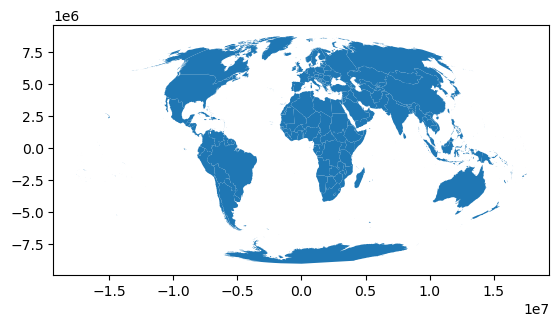

In [19]:
world.plot()

Define column to use for country-aggregation:

In [20]:
COUNTRY_COL = 'SU_A3'

These SU_A3 country codes are extended ISO codes, see [this](https://github.com/nvkelso/natural-earth-vector/blob/master/housekeeping/ne_admin_0_details.ods) ref table.

Only keep COUNTRY_COL column, SOVEREIGNT, and geometry:

In [21]:
columns_keep = ['geometry', 'SOVEREIGNT', COUNTRY_COL]
drop_cols_except(world, columns_keep)

## Country overlay with grid

First, write multi-index to columns, to later re-create the index:

In [22]:
grid_empty['xbin'] = grid_empty.index.get_level_values(0)
grid_empty['ybin'] = grid_empty.index.get_level_values(1)

Create an overlay, only stroing country-grid intersection:

In [23]:
%%time
grid_overlay = gp.overlay(
    grid_empty, world, 
    how='intersection')

CPU times: user 54.1 s, sys: 142 ms, total: 54.3 s
Wall time: 54.3 s


In [24]:
grid_overlay[grid_overlay[COUNTRY_COL] == "DEU"].head()

,xbin,ybin,SOVEREIGNT,SU_A3,geometry
37091,409904,6079952,Germany,DEU,"POLYGON ((459904.000 6031192.645, 457473.846 6..."
37092,409904,6029952,Germany,DEU,"POLYGON ((459904.000 5979952.000, 439777.346 5..."
37093,409904,5979952,Germany,DEU,"POLYGON ((459904.000 5979952.000, 459904.000 5..."
37094,459904,6179952,Germany,DEU,"POLYGON ((509904.000 6129952.000, 495314.233 6..."
37095,459904,6129952,Germany,DEU,"MULTIPOLYGON (((509904.000 6079952.000, 502808..."


<AxesSubplot:>

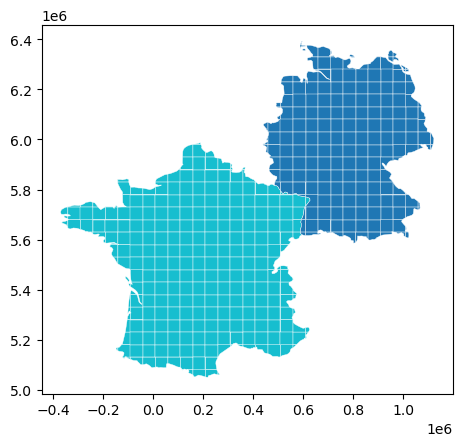

In [25]:
grid_overlay[
    grid_overlay[COUNTRY_COL].isin(["DEU", "FXX"])].plot(
    edgecolor='white', column=COUNTRY_COL, linewidth=0.3)

Calculate area:

In [26]:
grid_overlay["area"] = grid_overlay.area

In [27]:
grid_overlay[grid_overlay[COUNTRY_COL] == "DEU"].head()

,xbin,ybin,SOVEREIGNT,SU_A3,geometry,area
37091,409904,6079952,Germany,DEU,"POLYGON ((459904.000 6031192.645, 457473.846 6...",3.886671e+08
37092,409904,6029952,Germany,DEU,"POLYGON ((459904.000 5979952.000, 439777.346 5...",1.891485e+08
37093,409904,5979952,Germany,DEU,"POLYGON ((459904.000 5979952.000, 459904.000 5...",2.931637e+08
37094,459904,6179952,Germany,DEU,"POLYGON ((509904.000 6129952.000, 495314.233 6...",2.813983e+08
37095,459904,6129952,Germany,DEU,"MULTIPOLYGON (((509904.000 6079952.000, 502808...",2.012630e+08


In [28]:
grid_overlay.groupby(["xbin", "ybin"], sort=False).head()

,xbin,ybin,SOVEREIGNT,SU_A3,geometry,area
0,-17640096,-1970048,Fiji,FJI,"POLYGON ((-17596068.762 -1988932.933, -1759674...",1.375008e+07
1,-17590096,-2020048,Fiji,FJI,"MULTIPOLYGON (((-17558604.458 -2070048.000, -1...",2.640252e+08
2,-17590096,-2070048,Fiji,FJI,"POLYGON ((-17544904.267 -2070048.000, -1754482...",1.000075e+08
3,-17490096,-2070048,Fiji,FJI,"POLYGON ((-17440096.000 -2113755.099, -1744249...",1.220128e+07
4,-17440096,-2070048,Fiji,FJI,"POLYGON ((-17435352.110 -2120048.000, -1743544...",4.561355e+07
...,...,...,...,...,...,...
70868,17009904,929952,Marshall Islands,MHL,"POLYGON ((17059904.000 883328.346, 17059165.99...",7.021293e+05
70869,17059904,929952,Marshall Islands,MHL,"POLYGON ((17064020.522 879952.000, 17059904.00...",2.124275e+07
70870,17059904,879952,Marshall Islands,MHL,"POLYGON ((17070021.406 879952.000, 17079826.49...",7.197785e+07
70871,17109904,879952,Marshall Islands,MHL,"POLYGON ((17119886.235 867969.633, 17127193.92...",3.998398e+07


Next steps:  
- group by xbin/ybin and select max area per group
- get max id from area comparison per group
- select ISO_A3 column to assign values back (based on max area per bin)

In [29]:
idx_maxarea = grid_overlay.groupby(
    ["xbin", "ybin"], sort=False)['area'].idxmax()

In [30]:
idx_maxarea.head()

xbin       ybin    
-17640096  -1970048    0
-17590096  -2020048    1
           -2070048    2
-17490096  -2070048    3
-17440096  -2070048    4
Name: area, dtype: int64

In [31]:
bin_adm_maxarea = grid_overlay.loc[
    idx_maxarea, ["xbin", "ybin", COUNTRY_COL]]

Recreate index (Note: duplicate xbin/ybin indexes exist):

In [32]:
bin_adm_maxarea.set_index(
    ['xbin', 'ybin'], inplace=True)

In [33]:
bin_adm_maxarea.head()

SU_A3
xbin      ybin          
-17640096 -1970048   FJI
-17590096 -2020048   FJI
          -2070048   FJI
-17490096 -2070048   FJI
-17440096 -2070048   FJI

Assign back to grid:

In [34]:
grid_empty.loc[
    bin_adm_maxarea.index,
    COUNTRY_COL] = bin_adm_maxarea[COUNTRY_COL]

Set nan to Empty class

In [35]:
grid_empty.loc[
    grid_empty[COUNTRY_COL].isna(),
    COUNTRY_COL] = "Empty"

In [36]:
grid_empty[grid_empty[COUNTRY_COL] != "Empty"].head()

geometry  \
xbin      ybin                                                          
-17640096 -1970048  POLYGON ((-17640096.000 -1970048.000, -1759009...   
-17590096 -2020048  POLYGON ((-17590096.000 -2020048.000, -1754009...   
          -2070048  POLYGON ((-17590096.000 -2070048.000, -1754009...   
-17540096 -1720048  POLYGON ((-17540096.000 -1720048.000, -1749009...   
-17490096 -570048   POLYGON ((-17490096.000 -570048.000, -17440096...   

                        xbin     ybin SU_A3  
xbin      ybin                               
-17640096 -1970048 -17640096 -1970048   FJI  
-17590096 -2020048 -17590096 -2020048   FJI  
          -2070048 -17590096 -2070048   FJI  
-17540096 -1720048 -17540096 -1720048   WLF  
-17490096 -570048  -17490096  -570048   KIR

Check assignment

<AxesSubplot:>

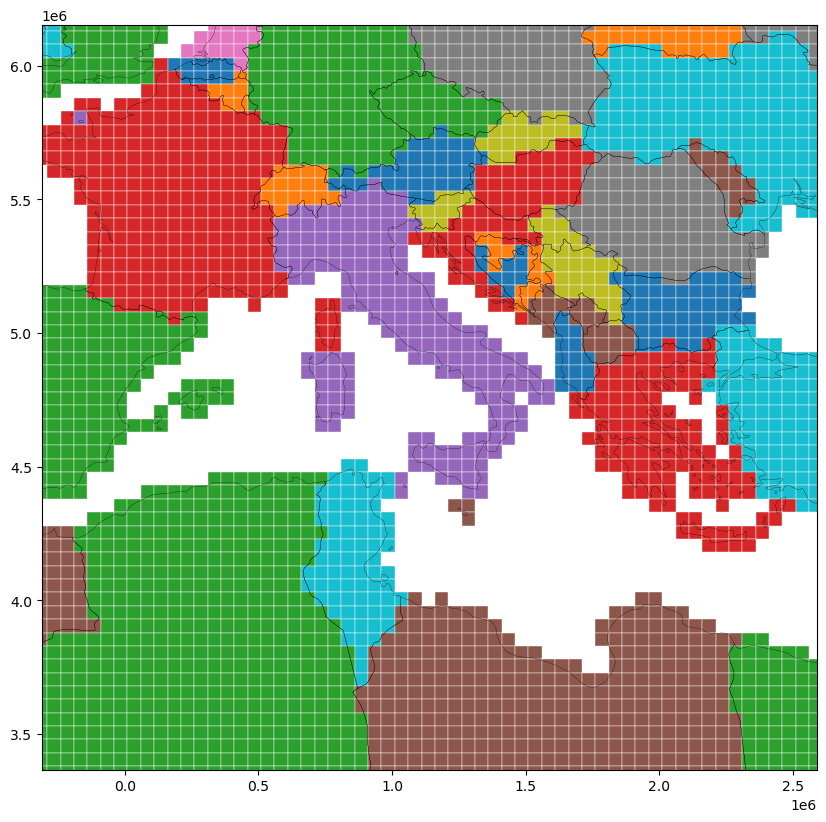

In [37]:
fig, ax = plt.subplots(1, 1, figsize=(10,12))
bbox_italy = (
    7.8662109375, 36.24427318493909,
    19.31396484375, 43.29320031385282)
buf = 1000000
# create bounds from WGS1984 italy and project to Mollweide
minx, miny = PROJ_TRANSFORMER.transform(
    bbox_italy[0], bbox_italy[1])
maxx, maxy = PROJ_TRANSFORMER.transform(
    bbox_italy[2], bbox_italy[3])
ax.set_xlim(minx-buf, maxx+buf)
ax.set_ylim(miny-buf, maxy+buf)
empty = grid_empty[grid_empty[COUNTRY_COL] == "Empty"].plot(
    ax=ax, edgecolor=None, facecolor='white', linewidth=0)
base = grid_empty[grid_empty[COUNTRY_COL] != "Empty"].plot(
    ax=ax, edgecolor='white', column=COUNTRY_COL, linewidth=0.3)
world.plot(
    ax=base, color='none', edgecolor='black', linewidth=0.2)

In [38]:
grid_empty.head()

geometry  \
xbin      ybin                                                         
-18040096 8979952  POLYGON ((-18040096.000 8979952.000, -17990096...   
          8929952  POLYGON ((-18040096.000 8929952.000, -17990096...   
          8879952  POLYGON ((-18040096.000 8879952.000, -17990096...   
          8829952  POLYGON ((-18040096.000 8829952.000, -17990096...   
          8779952  POLYGON ((-18040096.000 8779952.000, -17990096...   

                       xbin     ybin  SU_A3  
xbin      ybin                               
-18040096 8979952 -18040096  8979952  Empty  
          8929952 -18040096  8929952  Empty  
          8879952 -18040096  8879952  Empty  
          8829952 -18040096  8829952  Empty  
          8779952 -18040096  8779952  Empty

**Combine in a single method:**

In [39]:
def grid_assign_country(
    grid: gp.GeoDataFrame, countries: gp.GeoDataFrame,
    country_col: Optional[str] = COUNTRY_COL):
    """Assign countries code based on max area overlay to grid"""
    # get index as column
    grid['xbin'] = grid.index.get_level_values(0)
    grid['ybin'] = grid.index.get_level_values(1)
    # intersect
    grid_overlay = gp.overlay(
        grid, countries, 
        how='intersection')
    # calculate area
    grid_overlay["area"] = grid_overlay.area
    # select indexes based on area overlay
    idx_maxarea = grid_overlay.groupby(
        ["xbin", "ybin"], sort=False)["area"].idxmax()
    bin_country_maxarea = grid_overlay.loc[
        idx_maxarea, ["xbin", "ybin", country_col]]
    # recreate grid index
    bin_country_maxarea.set_index(
        ['xbin', 'ybin'], inplace=True)
    # assign country back to grid
    grid.loc[
        bin_country_maxarea.index,
        country_col] = bin_country_maxarea[country_col]
    # drop index columns not needed anymore
    grid.drop(
        ["xbin", "ybin"], axis=1, inplace=True)

### Optional: TFIDF country data

For exploring TFIDF per country, we'll also export country data here for PostGIS

**Grid to Postgis**

For further work, we'll export the SQL syntax here to import the 100km Grid to to Postgis (optional).
In addition,

- we'll need to insert the [Mollweide projection string](//epsg.io/54009.sql) to the spatial ref table.
- and create a table for the grid:

```sql
CREATE TABLE spatial. "grid100km" (
    xbin int,
    ybin int,
    PRIMARY KEY (xbin, ybin),
    su_a3 char(3),
    geometry geometry(Polygon, 54009)
);
```

<AxesSubplot:>

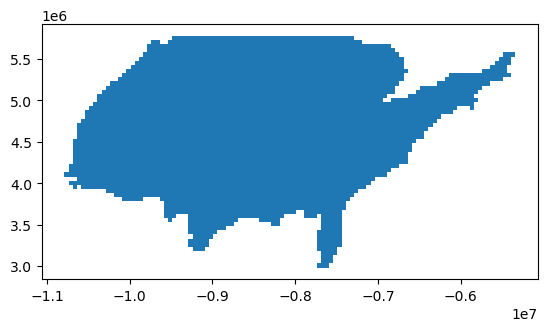

In [40]:
grid_empty[grid_empty[COUNTRY_COL] == "USB"].plot()

In [41]:
from shapely.wkt import dumps as wkt_dumps
    
def add_wkt_col(gdf: gp.GeoDataFrame):
    """Converts gdf.geometry to WKT (Well-Known-Text) as new column
    Requires `from shapely.wkt import dumps as wkt_dumps`"""
    gdf.loc[gdf.index, "geom_wkt"] = gdf["geometry"].apply(lambda x: wkt_dumps(x))

In [42]:
add_wkt_col(grid_empty)

value_list = ',\n'.join(
    f"({index[0]},{index[1]}, '{row[COUNTRY_COL]}', 'SRID=54009;{row.geom_wkt}')"
    for index, row in grid_empty[grid_empty[COUNTRY_COL] != "Empty"].iterrows())
with open(OUTPUT / "csv" / "grid_100km_Mollweide_WKT.sql", 'w') as wkt_file:
    wkt_file.write(
        f'''
        INSERT INTO spatial."grid100km" (
            xbin,ybin,su_a3,geometry)
        VALUES
        {value_list};
        ''')

**Country (su_a3) to Postgis**

```sql
CREATE TABLE spatial. "country_sua3" (
    su_a3 char(3),
    PRIMARY KEY (su_a3),
    geometry geometry(Geometry, 54009)
);
```

In [43]:
world_empty = world.copy().set_index("SU_A3").drop(columns=['SOVEREIGNT'])
add_wkt_col(world_empty)

In [44]:
world_empty.head()

,geometry,geom_wkt
SU_A3,,
ZWE,"POLYGON ((2987278.542 -2742733.921, 2979383.40...",POLYGON ((2987278.5419494602829218 -2742733.92...
ZMB,"POLYGON ((2976200.722 -1924957.705, 2961959.54...",POLYGON ((2976200.7224715156480670 -1924957.70...
YEM,"MULTIPOLYGON (((5181525.454 2047361.573, 51352...",MULTIPOLYGON (((5181525.4542204160243273 20473...
YES,"POLYGON ((5307347.563 1557616.990, 5313584.814...",POLYGON ((5307347.5630814759060740 1557616.990...
VNM,"MULTIPOLYGON (((10323687.558 1282070.654, 1032...",MULTIPOLYGON (((10323687.5583364013582468 1282...


In [45]:
value_list = ',\n'.join(
    f"('{index}', 'SRID=54009;{row.geom_wkt}')"
    for index, row in world_empty.iterrows())
with open(OUTPUT / "csv" / "country_sua3_Mollweide_WKT.sql", 'w') as wkt_file:
    wkt_file.write(
        f'''
        INSERT INTO spatial. "country_sua3" (
            su_a3,geometry)
        VALUES
        {value_list};
        ''')

## Load benchmark data

In [46]:
grid = pd.read_pickle(
    OUTPUT / f"pickles_50km" / "flickr_userdays_all_est_hll.pkl")

In [47]:
grid["userdays_hll"].dropna().head()

xbin       ybin   
-18040096   29952     \x138b4006221e8426e32a853ee4512366876f017dc384...
           -20048                                          \x138b4038c3
           -70048                                          \x138b402f41
-17840096   129952                                         \x138b401ae1
           -20048                                          \x138b403fe2
Name: userdays_hll, dtype: object

In [48]:
grid.dropna().head()

userdays_hll  \
xbin      ybin                                                         
-18040096  29952   \x138b4006221e8426e32a853ee4512366876f017dc384...   
          -20048                                        \x138b4038c3   
          -70048                                        \x138b402f41   
-17840096  129952                                       \x138b401ae1   
          -20048                                        \x138b403fe2   

                                                            geometry  
xbin      ybin                                                        
-18040096  29952   POLYGON ((-18040096.000 29952.000, -17990096.0...  
          -20048   POLYGON ((-18040096.000 -20048.000, -17990096....  
          -70048   POLYGON ((-18040096.000 -70048.000, -17990096....  
-17840096  129952  POLYGON ((-17840096.000 129952.000, -17790096....  
          -20048   POLYGON ((-17840096.000 -20048.000, -17790096....

## Assign Countries to grid:

The actual assignment takes pretty long. We will later store the assignment (bin-idx, country-idx) in a pickle that can be loaded.

In [49]:
%%time
grid_assign_country(
    grid, world, country_col=COUNTRY_COL)

CPU times: user 57.8 s, sys: 119 ms, total: 57.9 s
Wall time: 57.9 s


In [50]:
grid.head()

userdays_hll  \
xbin      ybin                   
-18040096 8979952          NaN   
          8929952          NaN   
          8879952          NaN   
          8829952          NaN   
          8779952          NaN   

                                                            geometry SU_A3  
xbin      ybin                                                              
-18040096 8979952  POLYGON ((-18040096.000 8979952.000, -17990096...   NaN  
          8929952  POLYGON ((-18040096.000 8929952.000, -17990096...   NaN  
          8879952  POLYGON ((-18040096.000 8879952.000, -17990096...   NaN  
          8829952  POLYGON ((-18040096.000 8829952.000, -17990096...   NaN  
          8779952  POLYGON ((-18040096.000 8779952.000, -17990096...   NaN

<AxesSubplot:>

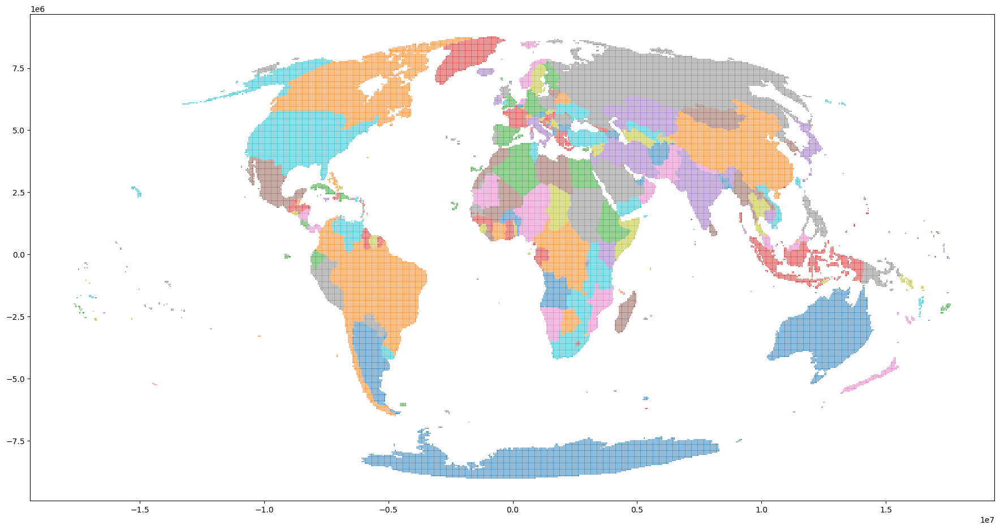

In [51]:
grid.plot(edgecolor='white', column=COUNTRY_COL, figsize=(22,28), linewidth=0.3)

## Merge hll sets per country and estimate cardinality

Merge hll sets per country id, connect to hll worker db:

In [52]:
DB_CONN = psycopg2.connect(
        host=DB_HOST,
        port=DB_PORT ,
        dbname=DB_NAME,
        user=DB_USER,
        password=DB_PASS
)
DB_CONN.set_session(
    readonly=True)
DB_CALC = tools.DbConn(
    DB_CONN)
CUR_HLL = DB_CONN.cursor()

In [53]:
db_conn = tools.DbConn(DB_CONN)
db_conn.query("SELECT 1;")

,?column?
0,1


## HLL Union

In [54]:
def union_hll(
    hll_series: pd.Series, db_conn: tools.DbConn, cardinality: bool = True,
    group_by: Optional[pd.Series] = None) -> pd.Series:
    """HLL Union and (optional) cardinality estimation from series of hll sets
    based on group by composite index.

    Args:
        hll_series: Indexed series (bins) of hll sets. 
        cardinality: If True, returns cardinality (counts). Otherwise,
            the unioned hll set will be returned.
        group_by: Optional Provide Series to group hll sets by. If None,
            Index will be used.
            
    The method will combine all groups of hll sets first,
        in a single SQL command. Union of hll hll-sets belonging 
        to the same group (bin) and (optionally) returning the cardinality 
        (the estimated count) per group will be done in postgres.
    
    By utilizing Postgres´ GROUP BY (instead of, e.g. doing 
        the group with numpy), it is possible to reduce the number
        of SQL calls to a single run, which saves overhead 
        (establishing the db connection, initializing the SQL query 
        etc.). Also note that ascending integers are used for groups,
        instead of their full original bin-ids, which also reduces
        transfer time.
    
    cardinality = True should be used when calculating counts in
        a single pass.
        
    cardinality = False should be used when incrementally union
        of hll sets is required, e.g. due to size of input data.
        In the last run, set to cardinality = True.
    """
    if group_by is None:
        group_by_series = hll_series.index
    else:
        group_by_series = group_by
    # group all hll-sets per index (bin-id)
    series_grouped = hll_series.groupby(
        group_by_series).apply(list)
    # From grouped hll-sets,
    # construct a single SQL Value list;
    # if the following nested list comprehension
    # doesn't make sense to you, have a look at
    # spapas.github.io/2016/04/27/python-nested-list-comprehensions/
    # with a decription on how to 'unnest'
    # nested list comprehensions to regular for-loops
    hll_values_list = ",".join(
        [f"({ix}::int,'{hll_item}'::hll)" 
         for ix, hll_items
         in enumerate(series_grouped.values.tolist())
         for hll_item in hll_items])
    # Compilation of SQL query,
    # depending on whether to return the cardinality
    # of unioned hll or the unioned hll
    return_col = "hll_union"
    hll_calc_pre = ""
    hll_calc_tail = "AS hll_union"
    if cardinality:
        # add sql syntax for cardinality 
        # estimation
        # (get count distinct from hll)
        return_col = "hll_cardinality"
        hll_calc_pre = "hll_cardinality("
        hll_calc_tail = ")::int"
    db_query = f"""
        SELECT sq.{return_col} FROM (
            SELECT s.group_ix,
                   {hll_calc_pre}
                   hll_union_agg(s.hll_set)
                   {hll_calc_tail}
            FROM (
                VALUES {hll_values_list}
                ) s(group_ix, hll_set)
            GROUP BY group_ix
            ORDER BY group_ix ASC) sq
        """
    df = db_conn.query(db_query)
    # to merge values back to grouped dataframe,
    # first reset index to ascending integers
    # matching those of the returned df;
    # this will turn series_grouped into a DataFrame;
    # the previous index will still exist in column 'index'
    df_grouped = series_grouped.reset_index()
    # drop hll sets not needed anymore
    df_grouped.drop(columns=[hll_series.name], inplace=True)
    # append hll_cardinality counts 
    # using matching ascending integer indexes
    df_grouped.loc[df.index, return_col] = df[return_col]
    # set index back to original bin-ids
    df_grouped.set_index(group_by_series.name, inplace=True)
    # return column as indexed pd.Series
    return df_grouped[return_col]

In [55]:
%%time
cardinality_series = union_hll(
    hll_series=grid["userdays_hll"].dropna(),
    group_by=grid[COUNTRY_COL],
    db_conn=db_conn)

CPU times: user 182 ms, sys: 64 ms, total: 246 ms
Wall time: 952 ms


In [56]:
cardinality_series.head()

SU_A3
ABW    6548
ACA    4837
ACB     207
AFG    7472
AGO    4243
Name: hll_cardinality, dtype: int64

## Assign HLL Cardinality to Countries

In [57]:
world.set_index(COUNTRY_COL, inplace=True)

In [58]:
world.loc[
    cardinality_series.index,
    "userdays_est"] = cardinality_series

Calculate area and normalize:

In [59]:
world["area"] = world.area
world["userdays_est_norm"] = ((world.userdays_est ** 2) / world.area)

In [60]:
world.head()

,SOVEREIGNT,geometry,userdays_est,area,userdays_est_norm
SU_A3,,,,,
ZWE,Zimbabwe,"POLYGON ((2987278.542 -2742733.921, 2979383.40...",4969.0,3.910570e+11,0.000063
ZMB,Zambia,"POLYGON ((2976200.722 -1924957.705, 2961959.54...",8066.0,7.572867e+11,0.000086
YEM,Yemen,"MULTIPOLYGON (((5181525.454 2047361.573, 51352...",2950.0,4.516298e+11,0.000019
YES,Yemen,"POLYGON ((5307347.563 1557616.990, 5313584.814...",346.0,3.526072e+09,0.000034
VNM,Vietnam,"MULTIPOLYGON (((10323687.558 1282070.654, 1032...",214834.0,3.296746e+11,0.139998


Preview plot:

<AxesSubplot:>

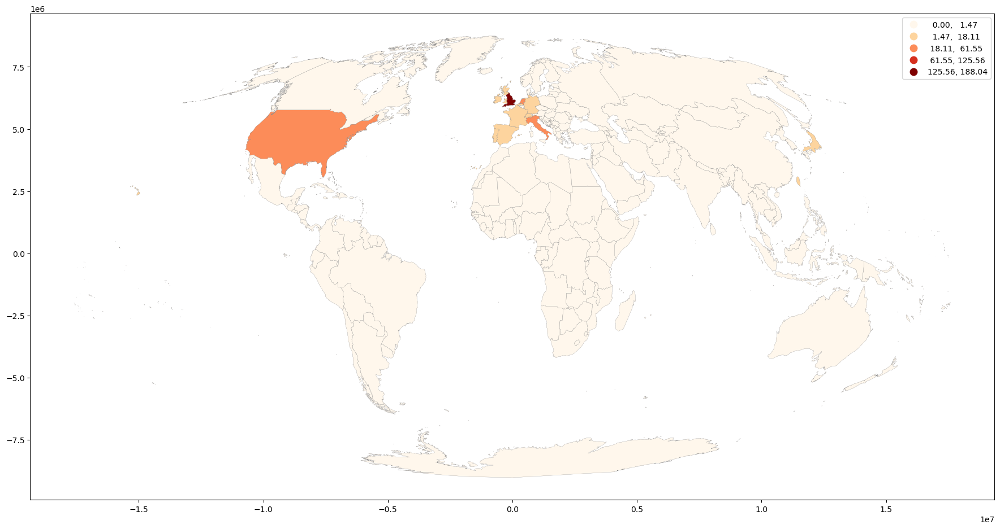

In [61]:
fig, ax = plt.subplots(1, 1, figsize=(22,28))
world.plot(
    column='userdays_est_norm',
    cmap='OrRd',
    ax=ax,
    linewidth=0.2,
    edgecolor='grey',
    legend=True,
    scheme='headtail_breaks')

Prepare method:

In [62]:
def merge_countries_grid(
    grid_countries: gp.GeoDataFrame, grid: gp.GeoDataFrame, 
    usecols: List[str], mask: Optional[pd.Series] = None):
    """Merge temporary country assigned grid data to grid geodataframe
    
    Args:
        grid_countries: Indexed GeoDataFrame with country data
        grid: Indexed GeoDataFrame target
        usecols: Col names to merge from countries
        mask: Optional boolean mask (pd.Series)
              to partially merge country data
    """
    for col in usecols:
        if mask is None:
            grid.loc[grid_countries.index, col] = grid_countries[col]
            continue
        grid_countries_mask = grid_countries.loc[mask, col]
        grid.loc[grid_countries_mask.index, col] = grid_countries_mask
        
def group_union_cardinality(
    countries: gp.GeoDataFrame, grid: gp.GeoDataFrame, 
    db_conn: tools.DbConn, 
    metric_hll: str = "usercount_hll",
    country_col: str = COUNTRY_COL,
    grid_countries_pickle: Optional[Path] = None):
    """Group hll sets per country and assign cardinality to countries
    
    Args:
        grid: Indexed GeoDataFrame with hll data to use in union
        countries: Country GeoDataFrame to group grid-bins and assign
            cardinality.
        country_col: Name/ID of column in country to use in group by
        metric_hll: the name of HLL column that is used in hll union
        db_conn: A (read-only) DB connection to PG HLL Worker, for HLL
            calculation.
        grid_countries_pickle: Optional path to store and load intermediate
            grid-country assignment
    """
    if grid_countries_pickle and grid_countries_pickle.exists():
        grid_countries_tmp = pd.read_pickle(
            grid_countries_pickle).to_frame()
        merge_countries_grid(
            grid_countries=grid_countries_tmp,
            grid=grid,
            usecols=[country_col])
    else:
        grid_assign_country(
            grid, countries, country_col=country_col)
        # store intermediate, to speed up later runs    
        if grid_countries_pickle:
            grid[country_col].to_pickle(
                grid_countries_pickle)
            print("Intermediate country-grid assignment written..")
    # calculate cardinality by hll union
    cardinality_series = union_hll(
        hll_series=grid[metric_hll].dropna(),
        group_by=grid[country_col],
        db_conn=db_conn)
    # set index
    if not countries.index.name == country_col:
        countries.set_index(country_col, inplace=True)
    # assign cardinality
    countries.loc[
        cardinality_series.index,
        metric_hll.replace("_hll", "_est")] = cardinality_series

In [63]:
def country_agg_frompickle(
    grid_pickle: Path, db_conn: tools.DbConn,
    ne_path: Path = NE_PATH, ne_filename: str = NE_FILENAME, 
    ne_uri: str = NE_URI, country_col: str = COUNTRY_COL,
    metric_hll: str = "usercount_hll") -> gp.GeoDataFrame:
    """Load grid pickle, load country shapefile, join cardinality to country
    and return country GeoDataFrame"""
    # prepare country gdf
    get_zip_extract(
        uri=ne_uri,
        filename=ne_filename,
        output_path=ne_path)
    world = gp.read_file(
        ne_path / ne_filename.replace(".zip", ".shp"))
    world = world.to_crs(CRS_PROJ)
    columns_keep = ['geometry', country_col]
    drop_cols_except(world, columns_keep)
    # prepare grid gdf
    grid = pd.read_pickle(
        grid_pickle)
    # check if intermediate country agg file already exists
    grid_countries_pickle = Path(
        ne_path / f'{km_size_str}_{ne_filename.replace(".zip", ".pickle")}')
    group_union_cardinality(
        world, grid, country_col=country_col, db_conn=db_conn,
        grid_countries_pickle=grid_countries_pickle, metric_hll=metric_hll)
    return world

Test:
- for userdays
- for usercount

In [64]:
metrics = ["userdays", "usercount"]

CPU times: user 7.39 s, sys: 348 ms, total: 7.73 s
Wall time: 8.57 s


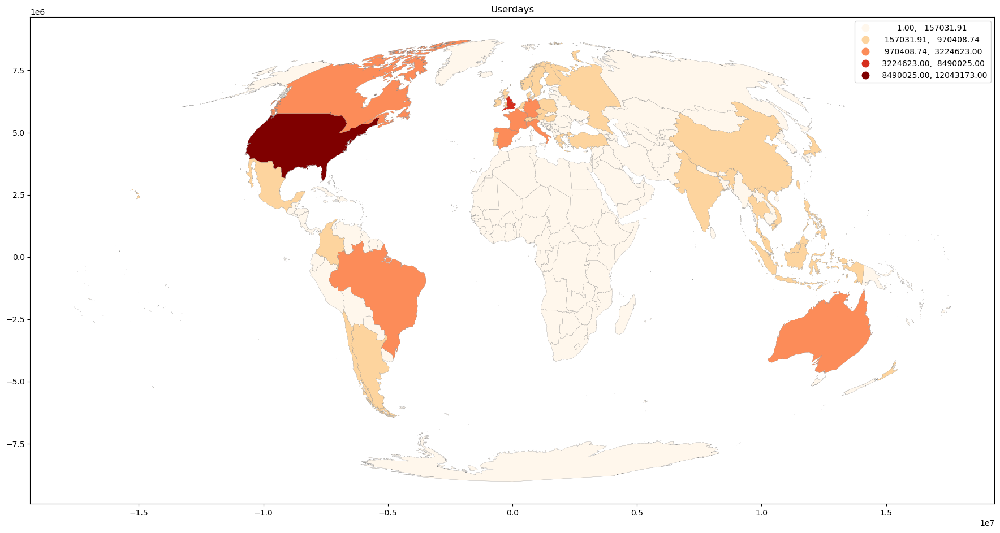

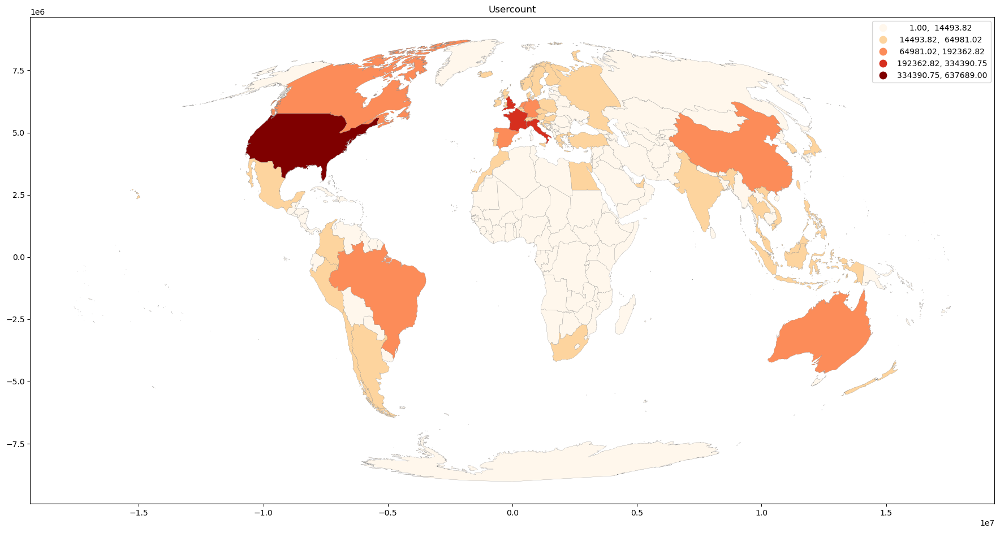

In [65]:
%%time
for metric in metrics:
    world = country_agg_frompickle(
        grid_pickle=OUTPUT / f"pickles_50km" / f"flickr_{metric}_all_est_hll.pkl",
        db_conn=db_conn, metric_hll=f"{metric}_hll")
    fig, ax = plt.subplots(1, 1, figsize=(22,28))
    ax.set_title(metric.capitalize())
    world.plot(
        column=f'{metric}_est',
        cmap='OrRd',
        ax=ax,
        linewidth=0.2,
        edgecolor='grey',
        legend=True,
        scheme='headtail_breaks')

# Calculate Chi

For chi, we need to combine results from expected versus observed per country. Basically, repeat the grid chi aggregation, just for countries.

In [66]:
CHI_COLUMN = f"usercount_est"
METRIC = CHI_COLUMN.replace("_est", "")

Calculate chi value according to [03_combine.ipynb](03_combine.ipynb)

In [67]:
%%time
world_observed = country_agg_frompickle(
    grid_pickle=OUTPUT / f"pickles_50km" / f"flickr_{METRIC}_sunset_est_hll.pkl",
    db_conn=db_conn, metric_hll=CHI_COLUMN.replace("_est", "_hll"))
world_expected = country_agg_frompickle(
    grid_pickle=OUTPUT / f"pickles_50km" / f"flickr_{METRIC}_all_est_hll.pkl",
    db_conn=db_conn, metric_hll=CHI_COLUMN.replace("_est", "_hll"))

CPU times: user 6.35 s, sys: 192 ms, total: 6.55 s
Wall time: 7.19 s


Calculate chi:

In [68]:
def calculate_country_chi(
        gdf_expected: gp.GeoDataFrame, gdf_observed: gp.GeoDataFrame,
        chi_column: str = CHI_COLUMN) -> gp.GeoDataFrame:
    """Calculate chi for expected vs observed based on two geodataframes (country geom)"""
    norm_val = calc_norm(
        gdf_expected, gdf_observed, chi_column=chi_column)
    rename_expected = {
        chi_column:f'{chi_column}_expected',
        }
    gdf_expected.rename(
        columns=rename_expected,
        inplace=True)
    merge_cols = [chi_column]
    gdf_expected_observed = gdf_expected.merge(
        gdf_observed[merge_cols],
        left_index=True, right_index=True)
    apply_chi_calc(
        grid=gdf_expected_observed,
        norm_val=norm_val,
        chi_column=chi_column)
    return gdf_expected_observed

In [69]:
%%time
world_expected_observed = calculate_country_chi(world_expected, world_observed)

CPU times: user 10.1 ms, sys: 56 µs, total: 10.1 ms
Wall time: 10 ms


In [70]:
world_expected_observed.head()

,geometry,usercount_est_expected,usercount_est,chi_value,significant
SU_A3,,,,,
ZWE,"POLYGON ((2987278.542 -2742733.921, 2979383.40...",1345.0,158.0,10.816126,True
ZMB,"POLYGON ((2976200.722 -1924957.705, 2961959.54...",2511.0,260.0,7.085320,True
YEM,"MULTIPOLYGON (((5181525.454 2047361.573, 51352...",740.0,38.0,-11.804480,True
YES,"POLYGON ((5307347.563 1557616.990, 5313584.814...",93.0,11.0,2.929983,False
VNM,"MULTIPOLYGON (((10323687.558 1282070.654, 1032...",31437.0,1442.0,-87.653996,True


<AxesSubplot:>

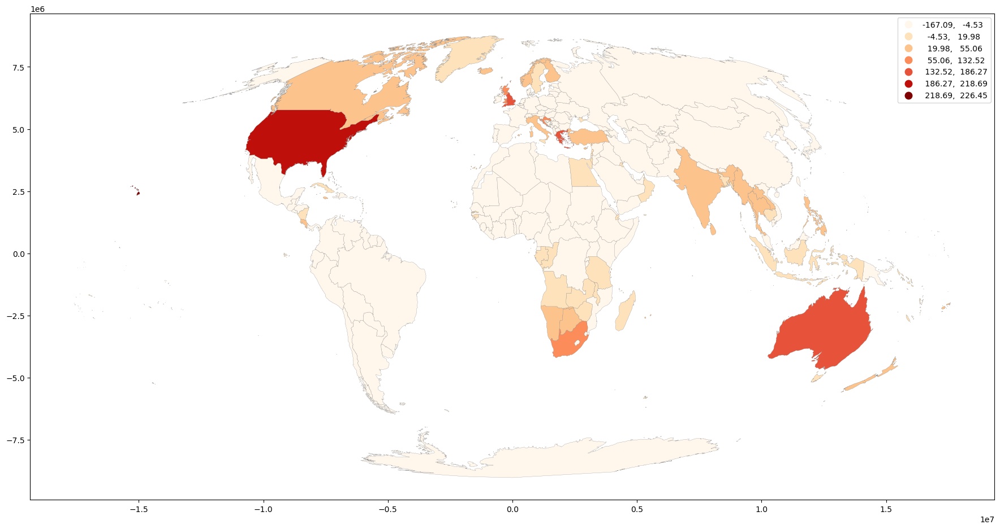

In [71]:
fig, ax = plt.subplots(1, 1, figsize=(22,28))
world_expected_observed.plot(
    column='chi_value',
    cmap='OrRd',
    ax=ax,
    linewidth=0.2,
    edgecolor='grey',
    legend=True,
    scheme='headtail_breaks')

Store full country chi gdf as CSV (used in 06_relationships.ipynb):

In [72]:
cols: List[str] = [f"{METRIC}_est_expected", f"{METRIC}_est", "chi_value", "significant"]
world_expected_observed.to_csv(OUTPUT / "csv" / f"countries_{METRIC}_chi_flickr_sunset.csv", mode='w', columns=cols, index=True)

Combine everything in one function:

In [73]:
def load_store_country_chi(
    topic: str, source: str, metric: str = METRIC, flickrexpected: bool = False, return_gdf: bool = None,
    store_csv: bool = False):
    """Load, calculate and plot country chi map based on topic (sunset, sunrise)
    and source (instagram, flickr)
    """
    chi_column = f"{metric}_est"
    world_observed = country_agg_frompickle(
        grid_pickle=OUTPUT / f"pickles_50km" / f"{source}_{metric}_{topic}_est_hll.pkl",
        db_conn=db_conn,
        metric_hll=f"{metric}_hll")
    if not flickrexpected and source == "instagram":
        # expected all not available for Instagram
        expected = f"{source}_{metric}_random"
    else:
        expected = f'flickr_{metric}_all'
    world_expected = country_agg_frompickle(
        grid_pickle=OUTPUT / f"pickles_50km" / f"{expected}_est_hll.pkl",
        db_conn=db_conn,
        metric_hll=f"{metric}_hll")
    # calculate chi
    world_expected_observed = calculate_country_chi(
        world_expected, world_observed, chi_column=chi_column)
    # store intermediate csv
    cols: List[str] = [
        f"{metric}_est_expected", f"{metric}_est", "chi_value", "significant"]
    ext = ""
    if flickrexpected and source == "instagram":
        ext = "_fe"
    if store_csv:
        world_expected_observed.to_csv(
            OUTPUT / "csv" / f"countries_{metric}_chi_{source}_{topic}{ext}.csv",
            mode='w', columns=cols, index=True)
    if return_gdf:
        return world_expected_observed

Repeat for userdays:

In [74]:
%%time
load_store_country_chi(
    topic="sunset", source="flickr", metric="userdays", store_csv = True)

CPU times: user 6.42 s, sys: 176 ms, total: 6.6 s
Wall time: 7.34 s


**Repeat for postcount:**

In [75]:
%%time
load_store_country_chi(
    topic="sunrise", source="flickr", metric="postcount", store_csv = True)

CPU times: user 5.8 s, sys: 180 ms, total: 5.98 s
Wall time: 6.86 s


In [76]:
%%time
load_store_country_chi(
    topic="sunset", source="flickr", metric="postcount", store_csv = True)

CPU times: user 6.73 s, sys: 204 ms, total: 6.94 s
Wall time: 7.9 s


In [77]:
%%time
load_store_country_chi(
    topic="sunrise", source="instagram", metric="postcount", store_csv = True)

CPU times: user 6.45 s, sys: 136 ms, total: 6.59 s
Wall time: 7.01 s


In [78]:
%%time
load_store_country_chi(
    topic="sunset", source="instagram", metric="postcount", store_csv = True)

CPU times: user 5.65 s, sys: 180 ms, total: 5.83 s
Wall time: 6.33 s


**Repeat for Sunrise**

In [79]:
%%time
load_store_country_chi(
    topic="sunrise", source="flickr", metric="usercount", store_csv = True)

CPU times: user 6.35 s, sys: 100 ms, total: 6.45 s
Wall time: 7.02 s


In [80]:
load_store_country_chi(
    topic="sunrise", source="flickr", metric="userdays", store_csv = True)

**Repeat for Instagram**

In [81]:
%%time
load_store_country_chi(
    topic="sunrise", source="instagram", metric="usercount", store_csv = True)

CPU times: user 6.34 s, sys: 164 ms, total: 6.5 s
Wall time: 6.91 s


In [82]:
%%time
load_store_country_chi(
    topic="sunrise", source="instagram", metric="userdays", store_csv = True)

CPU times: user 6.34 s, sys: 128 ms, total: 6.47 s
Wall time: 6.89 s


In [83]:
%%time
load_store_country_chi(
    topic="sunset", source="instagram", metric="usercount", store_csv = True)

CPU times: user 5.66 s, sys: 152 ms, total: 5.81 s
Wall time: 6.3 s


In [84]:
load_store_country_chi(
    topic="sunset", source="instagram", metric="userdays", store_csv = True)

# Visualization

Plot Interactive Country chi maps (diverging colormap).

**ToDo**: The code below is very similar to the one in `03_chimaps.ipynb` and `06_semantics.ipynb`. Can be reduced significantly with deduplication and refactoring.

Prepare methods. The first one is needed to plot country polygons in `hv` using geoviews `gv.Polygons`. The syntax is very similar to `convert_gdf_to_gvimage()`. There are further slight adjustments necessary to other methods, which are copied from previous notebooks.

We also need to create a [pooled classification](https://geographicdata.science/book/notebooks/05_choropleth.html#pooled-classifications), meaning that all values for all maps are used to create scheme breaks, and then those global breaks are used across maps to classify bins. This allows use to compare maps.

In [85]:
def convert_gdf_to_gvpolygons(
        poly_gdf: gp.GeoDataFrame, metric: str = METRIC, cat_count: Optional[int] = None, 
        cat_min: Optional[int] = None, cat_max: Optional[int] = None,
        hover_items: Dict[str, str] = None) -> gv.Polygons:
    """Convert GeoDataFrame to gv.polygons using categorized
    metric column as value dimension
    
    Args:
        poly_gdf: A geopandas geodataframe with  
            (projected coordinates) and aggregate metric column
        metric: target column for value dimension.
            "_cat" will be added to retrieve classified values.
        cat_count: number of classes for value dimension
        hover_items: a dictionary with optional names 
            and column references that are included in 
            gv.Image to provide additional information
            (e.g. on hover)
    """
    if cat_count:
        cat_min = 0
        cat_max = cat_count
    else:
        if any([cat_min, cat_max]) is None:
            raise ValueError(
                "Either provide cat_count or cat_min and cat_max.")
    if hover_items is None:
        hover_items_list = []
    else:
        hover_items_list = [
            v for v in hover_items.values()]
    # convert GeoDataFrame to gv.Polygons Layer
    # the first vdim is the value being used 
    # to visualize classes on the map
    # include additional_items (postcount and usercount)
    # to show exact information through tooltip
    gv_layer = gv.Polygons(
        poly_gdf,
        vdims=[
            hv.Dimension(
                f'{metric}_cat', range=(cat_min, cat_max))]
            + hover_items_list,
        crs=crs.Mollweide())
    return gv_layer

Derived from `get_classify_image`:

In [86]:
def compile_diverging_poly_layer(
        poly_gdf: gp.GeoDataFrame, series_plus: pd.Series,
        series_minus: pd.Series,
        metric: str = "chi_value", responsive: bool = None,
        hover_items: Dict[str, str] = hover_items,
        mask_nonsignificant: bool = False,
        add_notopicdata_label: str = None,
        scheme: str = "HeadTailBreaks",
        cmaps_diverging: Tuple[str] = ("OrRd", "Blues"),
        add_nodata_label: str = "#FFFFFF",
        true_negative: bool = True,
        bounds_plusminus: Tuple[List[str], List[str]] = (None, None),
        schemebreaks_plusminus: Tuple["mc.classifier", "mc.classifier"] = (None, None)):
    """Modified function to get/combine diverging image layer
    
    Additional Args:
        series_plus: Series of values to show on plus y range cmap
        series_minus: Series of values to show on minus y range cmap
        cmaps_diverging: Tuple with plus and minus cmap reference
        bounds: Optional predefined bounds (map comparison)
        scheme_breaks: Optional predefined scheme_breaks (map comparison)
    """
    ##stats = {}
    div_labels: List[Dict[int, str]] = []
    div_cmaps: List[List[str]] = []
    cat_counts: List[int] = []
    div_bounds: List[List[float]] = []
    spare_cats = 0
    plus_offset = 0
    offset = 0
    for ix, series_nan in enumerate([series_plus, series_minus]):
        # classify values for both series
        cmap_name = cmaps_diverging[ix]
        if bounds_plusminus[ix] and schemebreaks_plusminus[ix]:
            # get predifined breaks
            bounds = bounds_plusminus[ix]
            scheme_breaks = schemebreaks_plusminus[ix]
        else:
            # calculate new
            bounds, scheme_breaks = classify_data(
                values_series=series_nan, scheme=scheme)
        div_bounds.append(bounds)
        # assign categories column
        cat_series = scheme_breaks.find_bin(
            np.abs(series_nan.values))
        cat_count = scheme_breaks.k
        color_count = scheme_breaks.k + offset
        cmap_list = get_cmap_list(
            cmap_name, length_n=color_count)
        if ix == 0:
            if add_notopicdata_label:
                # add grey color
                plus_offset = 1
                prepend_color(
                    cmap_list=cmap_list, color_hex=add_notopicdata_label)
            if add_nodata_label:
                # offset
                spare_cats = 1
                prepend_color(
                    cmap_list=cmap_list, color_hex=add_nodata_label)
            cat_count += (offset+plus_offset)
            # nodata label as explicit category in legend
            # values will not be rendered on map (cat = nan):
            # increment cat count, but not series
            cat_series += (offset+plus_offset+spare_cats)
        if ix == 1:
            cat_count += offset
            # cat labels always prepended with minus sign (-)
            cat_series = np.negative(cat_series)
            # offset
            cat_series -= (1+offset)
        cat_counts.append(cat_count)
        div_cmaps.append(cmap_list)
        # assign categories
        poly_gdf.loc[series_nan.index, f'{metric}_cat'] = cat_series.astype(str)
    # general application:
    # assign special cat labels to data
    assign_special_categories(
        grid=poly_gdf, series_plus=series_plus, series_minus=series_minus,
        metric=metric, add_notopicdata_label=add_notopicdata_label,
        add_underrepresented_label=offset,
        add_nodata_label=add_nodata_label, mask_nonsignificant=mask_nonsignificant)
    # clean na() values !important
    mask = (poly_gdf[f'{metric}_cat'].isna())
    poly_gdf.loc[
        mask,
        f'{metric}_cat'] = '0'
    # poly_gdf[f'{metric}_cat'] = poly_gdf[f'{metric}_cat'].astype(str)
    # allow label cat to be shown on hover
    poly_gdf.loc[poly_gdf.index, f"{metric}_cat_label"] = poly_gdf[f"{metric}_cat"]
    hover_items['Label Cat'] = 'chi_value_cat_label'
    # special categories
    kwargs = {
        "mask_nonsignificant":mask_nonsignificant,
        "add_nodata_label":add_nodata_label,
        "add_notopicdata_label":add_notopicdata_label,
        "true_negative":true_negative,
        "offset":offset
    }
    label_dict = create_diverging_labels(
        div_bounds, **kwargs)
    # adjust tick positions, 
    # due to additional no_data_label
    # shown in legend only
    if add_nodata_label:
        label_dict = update_tick_positions(label_dict)
    # reverse colors of minus cmap
    # div_cmaps[1].reverse()
    # combine cmaps
    cmap_nodata_list = div_cmaps[1] + div_cmaps[0]
    cmap = colors.ListedColormap(cmap_nodata_list)
    # create gv.image layer from gdf
    gv_poly = convert_gdf_to_gvpolygons(
            poly_gdf=poly_gdf,
            metric=metric, cat_min=-cat_counts[1],
            cat_max=cat_counts[0],
            hover_items=hover_items)
    poly_layer = apply_polylayer_opts(
        gv_poly=gv_poly, cmap=cmap, label_dict=label_dict,
        responsive=responsive, hover_items=hover_items)
    return poly_layer    

In [87]:
def apply_polylayer_opts(
    gv_poly: gv.Polygons, cmap: colors.ListedColormap,
    label_dict: Dict[str, str], responsive: bool = None,
    hover_items: Dict[str, str] = None) -> gv.Image:
    """Apply geoviews polygons layer opts

    Args:
        gv_poly: A classified gv.Polygons layer
        responsive: Should be True for interactive HTML output.
        hover_items: additional items to show on hover
        cmap: A matplotlib colormap to colorize values and show as legend.
    """
    if hover_items is None:
        hover_items = {
        'Post Count (estimated)':'postcount_est', 
        'User Count (estimated)':'usercount_est',
        'User Days (estimated)':'userdays_est'}
    color_levels = len(cmap.colors)
    # define additional plotting parameters
    # width of static jupyter map,
    # 360° == 1200px
    width = 1200
    # height of static jupyter map,
    # 360°/2 == 180° == 600px
    height = int(width/2) 
    aspect = None
    # if stored as html,
    # override values
    if responsive:
        width = None
        height = None
    # define width and height as optional parameters
    # only used when plotting inside jupyter
    optional_kwargs = dict(width=width, height=height)
    # compile only values that are not None into kwargs-dict
    # by using dict-comprehension
    optional_kwargs_unpack = {
        k: v for k, v in optional_kwargs.items() if v is not None}
    # prepare custom HoverTool
    tooltips = get_custom_tooltips(
        hover_items)
    hover = HoverTool(tooltips=tooltips)
    # get tick positions from label dict keys
    ticks = [key for key in sorted(label_dict)]
    # create image layer
    return gv_poly.sort('chi_value_cat').opts(
            show_legend=True,
            color_levels=color_levels,
            cmap=cmap,
            colorbar=True,
            line_color='grey',
            line_width=0.3,
            clipping_colors={'NaN': 'transparent'},
            colorbar_opts={
                # 'formatter': formatter,
                'major_label_text_align':'left',
                'major_label_overrides': label_dict,
                'ticker': FixedTicker(
                    ticks=ticks),
                },
            tools=[hover],
            # optional unpack of width and height
            **optional_kwargs_unpack
        )

In [88]:
def combine_gv_layers(
        poly_layer: gv.Polygons, edgecolor: str = 'black',
        fill_color: str = '#dbdbdb', alpha: float = 0.15) -> gv.Overlay:
    """Combine layers into single overlay and set global plot options"""
    # fill_color = '#479AD4'
    # fill_color = '#E9EDEC'
    gv_layers = []
    gv_layers.append(
        gf.land.opts(
            alpha=alpha, fill_color=fill_color, line_width=0.5))
    gv_layers.append(
        poly_layer)
    return gv.Overlay(gv_layers)

In [89]:
from typing import Any
def get_gobal_scheme_breaks(
    series: pd.Series, scheme: str = "HeadTailBreaks") -> Tuple[Any, Any]:
        bounds, scheme_breaks = classify_data(
            values_series=series, scheme=scheme)
        return bounds, scheme_breaks

In [90]:
def get_combine_plus_minus(list_df: List[pd.DataFrame], mask_nonsignificant: bool = False,
    metric: str = "chi_value") -> Tuple[pd.Series, pd.Series]:
    """Merge (concat) all metric values of all dataframes to a single series. Returns
    two merged series for positive and negative values"""
    base_kwargs = {
        "mask_nonsignificant":mask_nonsignificant,
        "metric":metric}
    combined_plusminus = []
    mask_kwargs = ["mask_negative", "mask_positive"]
    for ix, mask_kwarg in enumerate(mask_kwargs):
        # merge two dictionaries
        kwargs = base_kwargs | { mask_kwarg:True }
        series_combined = None
        for df in list_df:
            df_copy = df.copy()
            masked_series = mask_series(
                grid=df_copy,
                **kwargs)
            if series_combined is None:
                series_combined = masked_series
                continue
            series_combined = pd.concat(
                [series_combined, masked_series], axis=0, 
                ignore_index=True)
        combined_plusminus.append(series_combined)
    return (combined_plusminus[0], combined_plusminus[1])

In [91]:
def plot_diverging_poly(poly_gdf: gp.GeoDataFrame, title: str,
    hover_items: Dict[str, str] = {
        'Post Count (estimated)':'postcount_est', 
        'User Count (estimated)':'usercount_est',
        'User Days (estimated)':'userdays_est'},
    mask_nonsignificant: bool = False,
    scheme: str = "HeadTailBreaks",
    cmaps_diverging: Tuple[str] = ("OrRd", "Blues"),
    store_html: str = None,
    plot: Optional[bool] = True,
    output: Optional[str] = OUTPUT,
    nodata_color: str = "#FFFFFF",
    notopicdata_color: str = None,
    true_negative: bool = True,
    bounds_plusminus: Tuple[List[str], List[str]] = (None, None),
    schemebreaks_plusminus: Tuple["mc.classifier", "mc.classifier"] = (None, None)) -> gv.Overlay:
    """Plot interactive map with holoviews/geoviews renderer

    Args:
        grid: A geopandas geodataframe with indexes x and y 
            (projected coordinates) and aggregate metric column
        metric: target column for aggregate. Default: postcount.
        store_html: Provide a name to store figure as interactive HTML.
        title: Title of the map
        cmaps_diverging: Tuple for colormaps to use.
        hover_items: additional items to show on hover
        mask_nonsignificant: transparent bins if significant column == False
        scheme: The classification scheme to use. Default "HeadTailBreaks".
        cmap: The colormap to use. Default "OrRd".
        plot: Prepare gv-layers to be plotted in notebook.
        true_negative: Whether "minus" values should show "-" in legend.
    """
    # work on a shallow copy,
    # to not modify original dataframe
    poly_gdf_plot = poly_gdf.copy()
    poly_gdf_plot['SU_A3'] = poly_gdf_plot.index
     # check if all additional items are available
    for key, item in list(hover_items.items()):
        if item not in poly_gdf_plot.columns:
            hover_items.pop(key)
    # chi layer opts
    base_kwargs = {
        "mask_nonsignificant":mask_nonsignificant,
        "metric":"chi_value",
    }
    # classify based on positive and negative chi
    series_plus = mask_series(
        grid=poly_gdf_plot,
        mask_negative=True,
        **base_kwargs)
    series_minus = mask_series(
        grid=poly_gdf_plot,
        mask_positive=True, 
        **base_kwargs)
    # global plotting options for value layer
    layer_opts = {
        "poly_gdf":poly_gdf_plot,
        "series_plus":series_plus,
        "series_minus":series_minus,
        "responsive":False,
        "scheme":scheme,
        "hover_items":hover_items,
        "cmaps_diverging":cmaps_diverging,
        "add_nodata_label":nodata_color,
        "add_notopicdata_label":notopicdata_color,
        "true_negative":true_negative,
        "bounds_plusminus":bounds_plusminus,
        "schemebreaks_plusminus":schemebreaks_plusminus
    }    
    # global plotting options for all layers (gv.Overlay)
    gv_opts = {
        "bgcolor":None,
        # "global_extent":True,
        "projection":crs.Mollweide(),
        "responsive":False,
        "data_aspect":1, # maintain fixed aspect ratio during responsive resize
        "hooks":[set_active_tool],
        "title":title
    }
    # get global plotting bounds/breaks for consistent scheme across all maps
    
    # plot responsive (html) or non-responsive (interactive)
    if plot:
        # get classified gv poly layer
        poly_layer = compile_diverging_poly_layer(
            **layer_opts, **base_kwargs)
        gv_layers = combine_gv_layers(
            poly_layer, fill_color=nodata_color, alpha=0.5)
    if store_html:
        layer_opts["responsive"] = True
        poly_layer = compile_diverging_poly_layer(
            **layer_opts, **base_kwargs)
        responsive_gv_layers = combine_gv_layers(
            poly_layer, fill_color=nodata_color, alpha=0.5)
        gv_opts["responsive"] = True
        export_layers = responsive_gv_layers.opts(**gv_opts)
        hv.save(
            export_layers,
            output / f"html" / f'{store_html}.html', backend='bokeh')
        if WEB_DRIVER:
            # store also as svg
            p =  hv.render(export_layers, backend='bokeh')
            p.output_backend = "svg"
            export_svgs(
                p, filename=output / f"svg{km_size_str}" / f'{store_html}.svg',
                webdriver=WEB_DRIVER)
    if not plot:
        return
    gv_opts["responsive"] = False
    return gv_layers.opts(**gv_opts)

In [92]:
hover_items = { 
    'User Count (est)':'usercount_est',
    'Country Code':'SU_A3'}
hover_items_chi = {
    f'Total {METRIC_NAME_REF[CHI_COLUMN]}':f'{CHI_COLUMN}_expected',
    'Chi-value':'chi_value',
    'Chi-significant':'significant',
    'Label Cat':'chi_value_cat_label'}
hover_items.update(hover_items_chi)  

Process data

In [93]:
world_flickr_sunset = load_store_country_chi(
    topic="sunset", source="flickr", metric="usercount", return_gdf=True)

In [94]:
world_flickr_sunrise = load_store_country_chi(
    topic="sunrise", source="flickr", metric="usercount", return_gdf=True)

Process Instagram data:
- expected based on random 20M (`flickrexpected = False`)
- or on flickr totals (`flickrexpected = True`)

In [95]:
flickrexpected = False
world_instagram_sunset = load_store_country_chi(
    topic="sunset", source="instagram", metric="usercount", flickrexpected=flickrexpected, return_gdf=True)

In [96]:
world_instagram_sunrise = load_store_country_chi(
    topic="sunrise", source="instagram", metric="usercount", flickrexpected=flickrexpected, return_gdf=True)

Set plotting args

In [97]:
kwargs = {
    "hover_items":hover_items,
    "cmaps_diverging":("OrRd", "Blues"),
    "scheme":"Quantiles",
    "mask_nonsignificant":False
}

Get global scheme breaks/classes

- the same class breaks will be applied to all *positive chi* values across all four maps
- the same class breaks will be applied to all *negative chi* values across all four maps

In [98]:
# 1. combine all plus and minus series
plus_series_merged, minus_series_merged = get_combine_plus_minus(
    [world_flickr_sunset, world_flickr_sunrise, world_instagram_sunset, world_instagram_sunrise])
# 2. get classes /breaks for combined series
plus_bounds, plus_scheme_breaks = get_gobal_scheme_breaks(plus_series_merged, scheme=kwargs.get("scheme"))
minus_bounds, minus_scheme_breaks = get_gobal_scheme_breaks(minus_series_merged, scheme=kwargs.get("scheme"))
kwargs["bounds_plusminus"] = (plus_bounds, minus_bounds)
kwargs["schemebreaks_plusminus"] = (plus_scheme_breaks, minus_scheme_breaks)

Print Legend labels and eval scheme breaks:

In [99]:
print(f'Plus: {plus_bounds}')
print(f'Plus scheme breaks: {plus_scheme_breaks}')
print(f'Minus: {minus_bounds}')
print(f'Minus scheme breaks: {minus_scheme_breaks}')

Plus: ['0', '3', '7', '13', '21', '31', '46', '74', '132', '700']
Plus scheme breaks: Quantiles               

    Interval       Count
------------------------
[  0.01,   3.15] |    69
(  3.15,   7.45] |    68
(  7.45,  12.64] |    69
( 12.64,  20.90] |    68
( 20.90,  31.33] |    69
( 31.33,  46.47] |    68
( 46.47,  74.34] |    69
( 74.34, 131.66] |    68
(131.66, 699.59] |    69
Minus: ['0', '3', '7', '11', '15', '21', '29', '46', '88', '709']
Minus scheme breaks: Quantiles               

    Interval       Count
------------------------
[  0.07,   2.82] |    58
(  2.82,   6.63] |    57
(  6.63,  10.53] |    57
( 10.53,  14.97] |    57
( 14.97,  21.15] |    58
( 21.15,  29.02] |    57
( 29.02,  46.01] |    57
( 46.01,  87.92] |    57
( 87.92, 709.02] |    58


In [100]:
world_instagram_sunset['chi_value'].max()

699.5888929612047

In [101]:
title=f'Chi values (over- and underrepresentation): Flickr "Sunset" {METRIC_NAME_REF[CHI_COLUMN]} (estimated) for Countries, 2007-2018'
pd.set_option('display.max_colwidth', 500)
gv_plot = plot_diverging_poly(
    world_flickr_sunset,
    title=title,
    store_html=f"countries_sunset_flickr_chi_usercount_{kwargs.get('scheme')}", **kwargs)
gv_plot

/opt/conda/envs/worker_env/lib/python3.9/site-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_land.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


:Overlay
   .Land.I     :Feature   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]   (chi_value_cat,usercount_est,SU_A3,usercount_est_expected,chi_value,significant,chi_value_cat_label)

> QUANTILES will create attractive maps that place an equal number of observations in each class: If you have 30 counties and 6 data classes, you’ll have 5 counties in each class. The problem with quantiles is that you can end up with classes that have very different numerical ranges (e.g., 1-4, 4-9, 9-250).

> NATURAL BREAKS is a kind of “optimal” classification scheme that finds class breaks that will minimize within-class variance and maximize between-class differences. One drawback of this approach is each dataset generates a unique classification solution, and if you need to make comparison across maps, such as in an atlas or a series (e.g., one map each for 1980, 1990, 2000) you might want to use a single scheme that can be applied across all of the maps.

Compare to matplotlib rendered plot with single color cmap:
- define plotting parameter

In [102]:
base_kwargs = {
    "column":'chi_value',
    "edgecolor":'grey',
    }
all_kwargs = {
    "cmap":'OrRd',
    "linewidth":0.2,
    "legend":True,
    "k":9,
    "scheme":'quantiles'    
    }
hatch_kwargs = {
    "hatch":"///",
    "alpha":0.5,
    "facecolor":"none",
    "linewidth":0
    }

- plot in two steps, using linear color gradient and hatch to label underrepresented

Text(0.5, 1.0, 'Chi values (over- and underrepresentation): Flickr "Sunset" User Count (estimated) for Countries, 2007-2018')

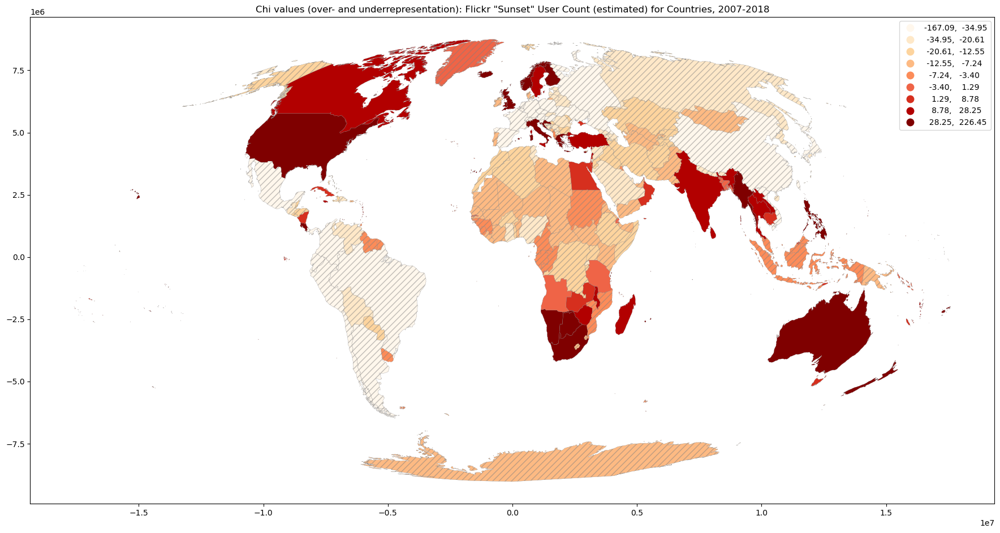

In [103]:
fig, ax = plt.subplots(1, 1, figsize=(22,28))
world_flickr_sunset.plot(
    ax=ax, **base_kwargs, **all_kwargs)
world_flickr_sunset[world_flickr_sunset['chi_value']<0].plot(
    ax=ax, **base_kwargs, **hatch_kwargs)
ax.set_title(title)

In [104]:
title=f'Chi values (over- and underrepresentation): Flickr "Sunrise" {METRIC_NAME_REF[CHI_COLUMN]} (estimated) for Countries, 2007-2018'
gv_plot = plot_diverging_poly(
    world_flickr_sunrise,
    title=title,
    store_html=f"countries_sunrise_flickr_chi_usercount_{kwargs.get('scheme')}", **kwargs)
gv_plot

:Overlay
   .Land.I     :Feature   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]   (chi_value_cat,usercount_est,SU_A3,usercount_est_expected,chi_value,significant,chi_value_cat_label)

Compare to matplotlib rendered plot (without synced/pooled cmap/classes):

Text(0.5, 1.0, 'Chi values (over- and underrepresentation): Flickr "Sunrise" User Count (estimated) for Countries, 2007-2018')

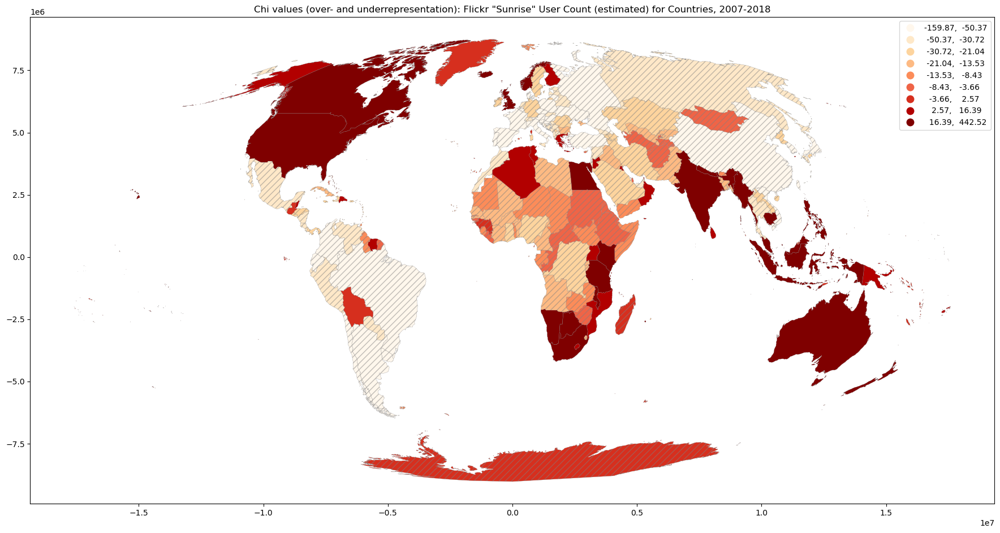

In [105]:
fig, ax = plt.subplots(1, 1, figsize=(22,28))
world_flickr_sunrise.plot(
    ax=ax, **base_kwargs, **all_kwargs)
world_flickr_sunrise[world_flickr_sunrise['chi_value']<0].plot(
    ax=ax, **base_kwargs, **hatch_kwargs)
ax.set_title(title)

In [106]:
title=f'Chi values (over- and underrepresentation): Instagram "Sunset" {METRIC_NAME_REF[CHI_COLUMN]} (estimated) for Countries, Aug-Dec 2017'
gv_plot = plot_diverging_poly(
    world_instagram_sunset,
    title=title,
    store_html=f"countries_sunset_instagram_chi_usercount_{kwargs.get('scheme')}{'_flickrexpected' if flickrexpected else ''}", **kwargs)
gv_plot

:Overlay
   .Land.I     :Feature   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]   (chi_value_cat,usercount_est,SU_A3,usercount_est_expected,chi_value,significant,chi_value_cat_label)

Compare to matplotlib rendered plot (without synced/pooled cmap/classes):

Text(0.5, 1.0, 'Chi values (over- and underrepresentation): Instagram "Sunset" User Count (estimated) for Countries, Aug-Dec 2017')

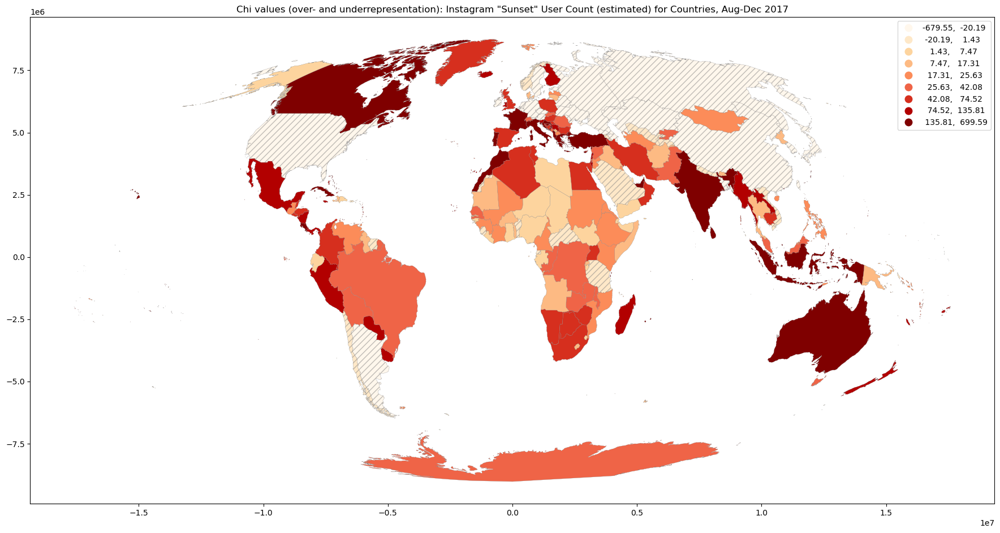

In [107]:
fig, ax = plt.subplots(1, 1, figsize=(22,28))
world_instagram_sunset.plot(
    ax=ax, **base_kwargs, **all_kwargs)
world_instagram_sunset[world_instagram_sunset['chi_value']<0].plot(
    ax=ax, **base_kwargs, **hatch_kwargs)
ax.set_title(title)

In [108]:
title=f'Chi values (over- and underrepresentation): Instagram "Sunrise" {METRIC_NAME_REF[CHI_COLUMN]} (estimated) for Countries, Aug-Dec 2017'
gv_plot = plot_diverging_poly(
    world_instagram_sunrise,
    title=title,
    store_html=f"countries_sunrise_instagram_chi_usercount_{kwargs.get('scheme')}{'_flickrexpected' if flickrexpected else ''}", **kwargs)
gv_plot

:Overlay
   .Land.I     :Feature   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]   (chi_value_cat,usercount_est,SU_A3,usercount_est_expected,chi_value,significant,chi_value_cat_label)

Compare to matplotlib rendered plot (without synced/pooled cmap/classes):

Text(0.5, 1.0, 'Chi values (over- and underrepresentation): Instagram "Sunrise" User Count (estimated) for Countries, Aug-Dec 2017')

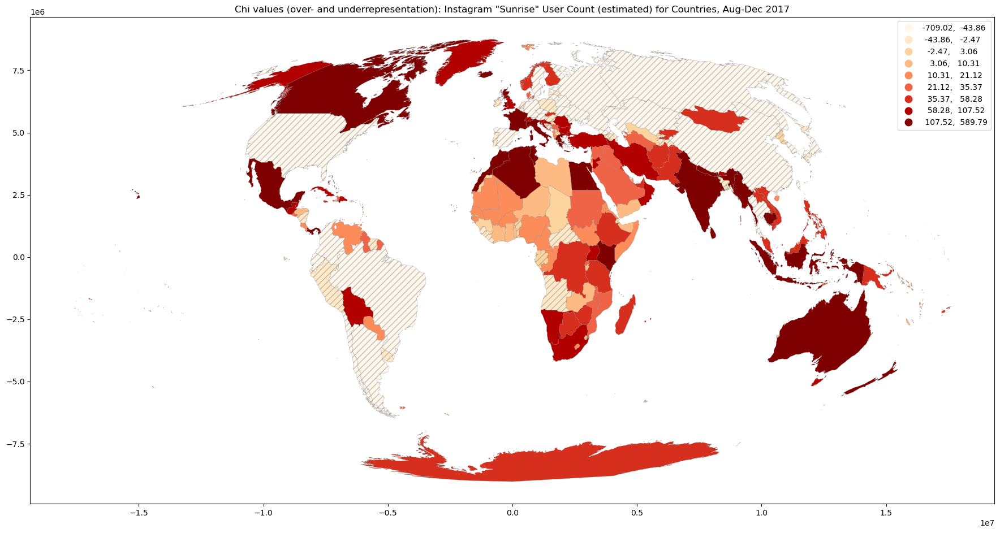

In [109]:
fig, ax = plt.subplots(1, 1, figsize=(22,28))
world_instagram_sunrise.plot(
    ax=ax, **base_kwargs, **all_kwargs)
world_instagram_sunrise[world_instagram_sunrise['chi_value']<0].plot(
    ax=ax, **base_kwargs, **hatch_kwargs)
ax.set_title(title)

world_flickr_sunset### Pooled Classification

Create the combined figure for the paper, based on pooled classification.

First, combine values into single dataframe.

In [110]:
world = world_flickr_sunset
world.rename(columns={'chi_value':'flickrsunset'}, inplace=True)
world.rename(columns={'significant':'significant_flickrsunset'}, inplace=True)
world.rename(columns={'usercount_est':'usercount_est_flickrsunset'}, inplace=True)
world.rename(columns={'usercount_est_expected':'usercount_est_expected_flickr'}, inplace=True)
world['flickrsunset'] = world['flickrsunset'].astype('float')
world['flickrsunrise'] = world_flickr_sunrise['chi_value'].astype('float')
world['usercount_est_flickrsunrise'] = world_flickr_sunrise['usercount_est'].astype('float')
world['significant_flickrsunrise'] = world_flickr_sunrise['significant']
world['instagramsunset'] = world_instagram_sunset['chi_value'].astype('float')
world['instagramsunrise'] = world_instagram_sunrise['chi_value'].astype('float')
world['significant_instagramsunrise'] = world_instagram_sunrise['significant']
world['usercount_est_instagramsunrise'] = world_instagram_sunrise['usercount_est'].astype('float')
world['usercount_est_instagramsunset'] = world_instagram_sunset['usercount_est'].astype('float')
world['usercount_est_expected_instagram'] = world_instagram_sunset['usercount_est_expected'].astype('float')
world['significant_instagramsunset'] = world_instagram_sunset['significant']
world.fillna(0, inplace=True)

Specify the columns to be used for pooled classification

In [111]:
submaps = ["flickrsunrise","flickrsunset","instagramsunrise","instagramsunset"]
# Create pooled classification
k_classes = 18
pooled = mc.Pooled(
    world[submaps], classifier='Quantiles', k=k_classes
)

In [112]:
pooled.global_classifier.bins

array([-7.21350945e+01, -3.76494048e+01, -2.40401678e+01, -1.65053352e+01,
       -1.07166104e+01, -5.81677972e+00, -1.77537441e+00,  0.00000000e+00,
        1.08146617e-01,  3.19047689e+00,  7.61108909e+00,  1.27635435e+01,
        2.10064008e+01,  3.15454240e+01,  4.68749952e+01,  7.44087720e+01,
        1.32223741e+02,  6.99588893e+02])

In [113]:
title_ref = {
    "flickrsunset":f'Flickr Sunset',
    "flickrsunrise":f'Flickr Sunrise',
    "instagramsunset":f'Instagram Sunset',
    "instagramsunrise":f'Instagram Sunrise'
}

The colormap that is used in 100x100km grids (`get_cmap_list()` in `02_visualization.ipynb`) results in two quite dark colors for max (minus and plus).

Below, this will be slighlty adapted, with a lighter color. Also, instead of blue, use purple, to not confuse sunset-sunrise meaning of blue/red in other graphics.

In [114]:
def get_diverging_colormap(cmap_diverging:Tuple[str, str], color_count: int = 9):
    """Create a diverging colormap from two existing with k classes"""
    div_cmaps: List[List[str]] = []
    for ix, cmap_name in enumerate(cmap_diverging):
        if ix == 1:
            # offset by 1, to darken first color a bit
            cmap =  plt.cm.get_cmap(cmap_name, color_count+1)
        cmap = plt.cm.get_cmap(cmap_name, color_count)
        cmap_list = get_hex_col(cmap)
        if ix == 0:
            # set first color as white
            cmap_list[0] = '#ffffff'
        if ix == 1:
            # remove first (too light) color
            cmap_list.pop(0)
        div_cmaps.append(cmap_list)
    div_cmaps[1] = list(reversed(div_cmaps[1]))
    cmap_nodata_list = div_cmaps[1] + div_cmaps[0]
    return colors.ListedColormap(cmap_nodata_list)

Experiment with values below.

In [115]:
# cmaps_diverging: Tuple[str] = ("OrRd", "Purples")
cmaps_diverging: Tuple[str] = ("OrRd", "Blues")
cmap = get_diverging_colormap(cmaps_diverging, color_count=(k_classes/2)+1)

In [116]:
len(cmap.colors)

19

Preview colormap (also useful for legend).

In [117]:
tools.display_hex_colors(cmap.colors, as_id=True)

,00000,00001,00002,00003,00004,00005,00006,00007,00008,00009,00010,00011,00012,00013,00014,00015,00016,00017,00018
0,,,,,,,,,,,,,,,,,,,


Use `False` for legend below to store figure.

In [118]:
import matplotlib as mpl
# adjust hatch width
mpl.rcParams['hatch.linewidth'] = 2

all_kwargs = {
    "cmap":cmap,
    "edgecolor":'grey',
    "linewidth":0.2,
    "legend":True,   
    }
hatch_kwargs = {
    "hatch":"///",
    "alpha":1.0,
    "edgecolor":"white",
    "facecolor":"none",
    "linewidth":0,
    }

Total number of countries:

In [401]:
len(world)

307

Count the number of total and non-significant countries for Flickr sunrise:

In [402]:
len(world[world["significant_flickrsunrise"]==False])

65

.. and Flickr sunset:

In [404]:
len(world[world["significant_flickrsunset"]==False])

72

Count the number of total and non-significant countries for Instagram sunset:

In [405]:
len(world[world["significant_instagramsunset"]==False])

52

Count the number of total and non-significant countries for Instagram sunrise:

In [406]:
len(world[world["significant_instagramsunrise"]==False])

59

Print the top 10 non-significant countries sorted by `usercount_est`(decending) for **Flickr/Sunset**:

In [407]:
world[world["significant_flickrsunset"]==False].drop(
    world.columns.difference(
        ["usercount_est_expected_flickr", "usercount_est_flickrsunset", "significant_flickrsunset"]),
    axis=1,
    inplace=False).sort_values(
        ["usercount_est_flickrsunset"], ascending=False).head(10)

,usercount_est_expected_flickr,usercount_est_flickrsunset,significant_flickrsunset
SU_A3,,,
CUB,11826.0,1108.0,False
TZA,5612.0,515.0,False
BGD,5229.0,455.0,False
PMD,4332.0,373.0,False
OMN,3289.0,317.0,False
KWT,2745.0,232.0,False
RUC,2398.0,225.0,False
PAZ,2424.0,212.0,False
ECG,2115.0,198.0,False


Print the top 10 non-significant countries sorted by `usercount_est`(decending) for **Instagram/Sunset**:

In [408]:
world[world["significant_instagramsunset"]==False].drop(
    world.columns.difference(
        ["usercount_est_expected_instagram", "usercount_est_instagramsunset", "significant_instagramsunset"]),
    axis=1,
    inplace=False).sort_values(
        ["usercount_est_instagramsunset"], ascending=False).head(10)

,usercount_est_instagramsunset,usercount_est_expected_instagram,significant_instagramsunset
SU_A3,,,
NOR,24498.0,83627.0,False
DOM,6327.0,21275.0,False
ECD,4655.0,15416.0,False
ARM,1266.0,4417.0,False
GHA,552.0,1765.0,False
LBY,277.0,852.0,False
DNB,268.0,942.0,False
AIA,136.0,398.0,False
DMA,106.0,434.0,False


These are all pretty small countries or islands. Lets compare the area/size of non-significant cpuntries

In [409]:
area_instagramsunset_nonsignificant = \
    world.loc[(world["significant_instagramsunset"]==False), 'geometry'].area.sum()
area_instagramsunset_significant = \
    world.loc[(world["significant_instagramsunset"]==True), 'geometry'].area.sum()
percentage_sunset = area_instagramsunset_nonsignificant/(area_instagramsunset_significant/100)

In [410]:
print(f'{area_instagramsunset_significant/1000000:,.0f} km² significant')
print(f'{area_instagramsunset_nonsignificant/1000000:,.0f} km² non-significant')
print(f'{percentage_sunset:.0f}%')

143,807,670 km² significant
2,980,617 km² non-significant
2%


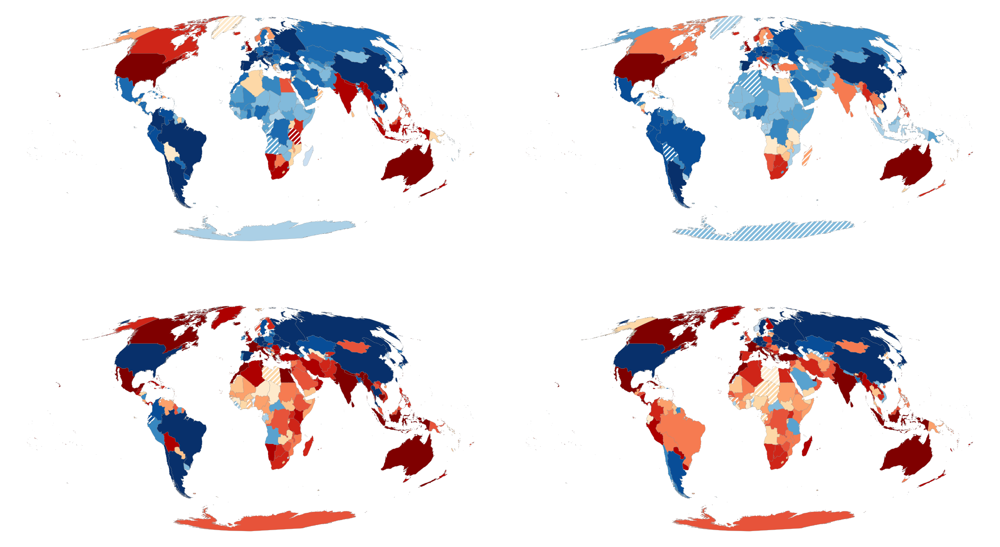

In [415]:
fig, axs = plt.subplots(2, 2, figsize=(22, 22))

# Flatten the array of axis so you can loop over
# in one dimension
axs = axs.flatten()
# Loop over each map
topic = "flickr"
for i, col in enumerate(submaps):
    if i >= 2:
        topic = "instagram"
    if (i % 2) == 0:
        topicsel = f'{topic}sunset'
    else:
        topicsel = f'{topic}sunrise'
    world.plot(
        col,                  # Year to plot
        scheme='UserDefined', # Use our own bins
        classification_kwds={ # Use global bins
            'bins': pooled.global_classifier.bins
        }, 
        ax=axs[i],             # Plot on the corresponding axis
        **all_kwargs
    )
    # hatch non-significant
    world[world[f"significant_{topicsel}"]==False].plot(
        ax=axs[i], **hatch_kwargs)
    # Remove axis
    axs[i].set_axis_off()
    # Name the subplot with the name of the column
    if all_kwargs.get("legend"):
        axs[i].set_title(title_ref.get(col))
fig.subplots_adjust(hspace=-0.7)
# Tight layout to better use space
plt.tight_layout()
# Display figure
plt.show()
if not all_kwargs.get("legend"):
    fig.savefig(
        OUTPUT / "figures" / "country_chi.png", dpi=300, format='PNG',
        bbox_inches='tight', pad_inches=1, facecolor="white")
    # also save as svg
    fig.savefig(
        OUTPUT / "svg" / "country_chi.svg", format='svg',
        bbox_inches='tight', pad_inches=1, facecolor="white")

# Close DB connection & Create notebook HTML

In [119]:
DB_CONN.close ()

In [120]:
!jupyter nbconvert --to html_toc \
    --output-dir=../out/html ./05_countries.ipynb \
    --template=../nbconvert.tpl \
    --ExtractOutputPreprocessor.enabled=False >&- 2>&- # create single output file

Copy single HTML file to resource folder

In [121]:
!cp ../out/html/05_countries.html ../resources/html/